# PROYECTO FINAL
### Neurociencias 5to semestre
Vladimir Abisai Espinosa Torrijos

### 1) Definir grafos con la matriz estableciendo umbrales de coactivacion de 0.8, 0.9 y 1 y graficar cada grafo. Añadir las coordenadas tridimencionales (incluidas en el archivo mat)

Para el grafo 0.2, existen las siguientes coordenadas de Conexiones:

CONEXION:  x:  [7.55725190839695, 9.115879828326186] y:  [33.8320610687023, 22.454935622317606] z [23.511450381679396, 24.206008583690988]
CONEXION:  x:  [-5.214035087719296, -5.017094017094024] y:  [-12.526315789473685, -5.7521367521367495] z [42.11929824561403, 37.66666666666667]
CONEXION:  x:  [-5.198237885462561, -5.677419354838705] y:  [17.823788546255514, 26.66129032258064] z [36.889867841409696, 40.314516129032256]
CONEXION:  x:  [-8.016597510373444, -6.0297029702970235] y:  [-38.016597510373444, -38.00990099009901] z [48.73858921161826, 40.95049504950495]
CONEXION:  x:  [-6.114942528735625, -4.257142857142853] y:  [-34.67432950191571, -42.409523809523805] z [34.643678160919535, 28.799999999999997]
CONEXION:  x:  [8.1869918699187, 8.421940928270047] y:  [19.86178861788619, 26.405063291139243] z [33.11382113821138, 36.42194092827005]
CONEXION:  x:  [-8.206489675516224, -6.972111553784856] y:  [-68.3303834808259

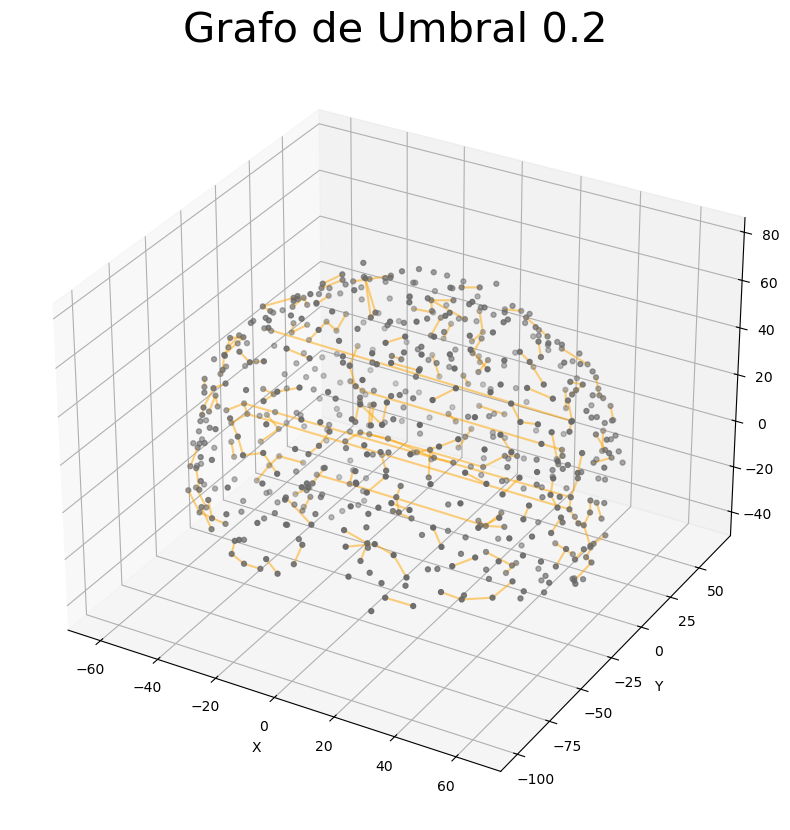

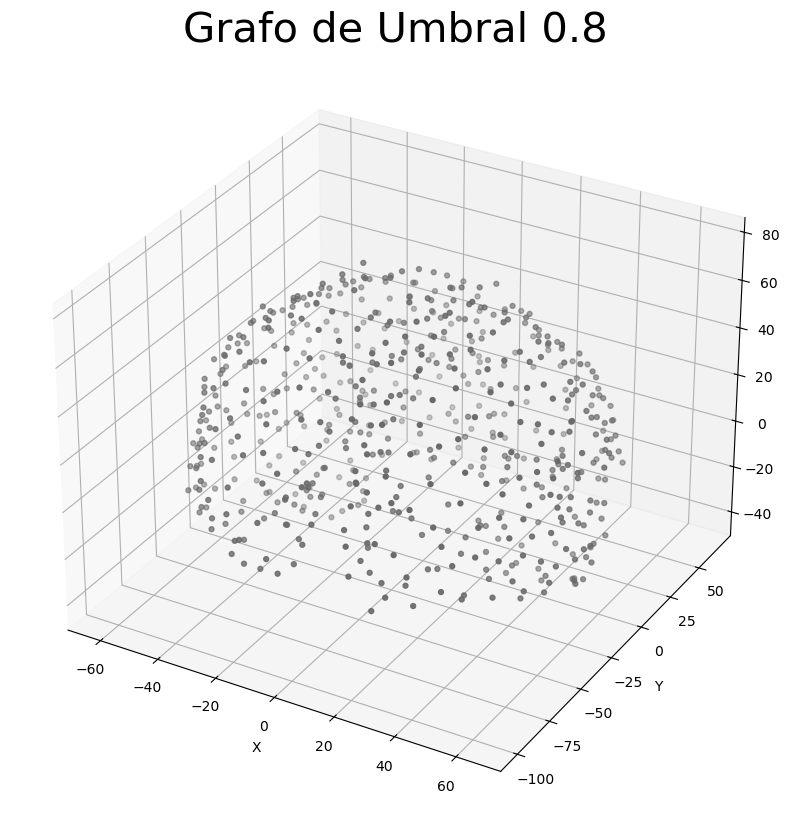

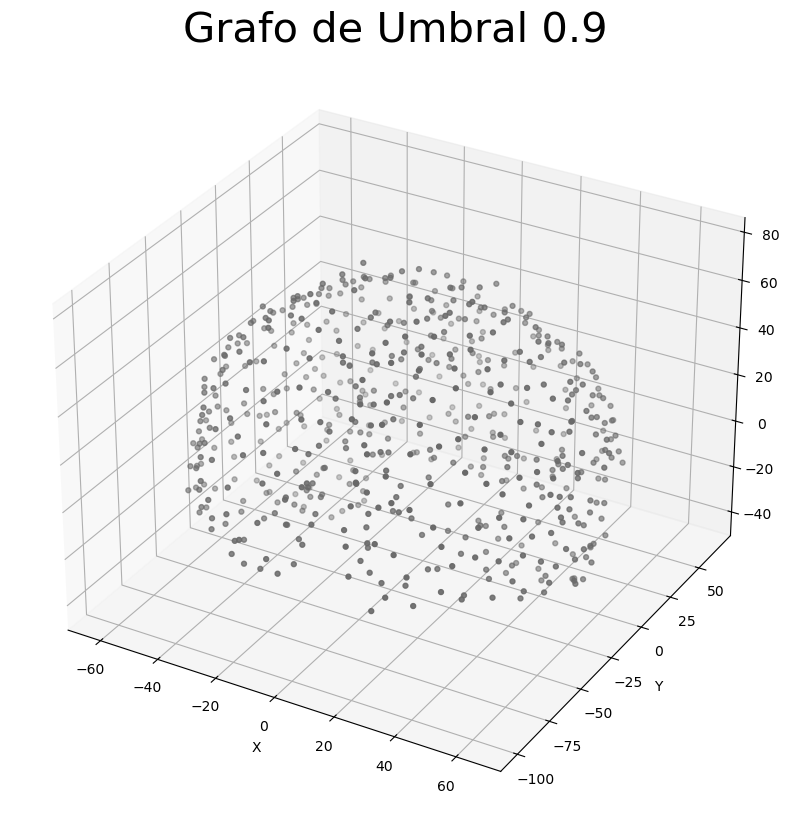

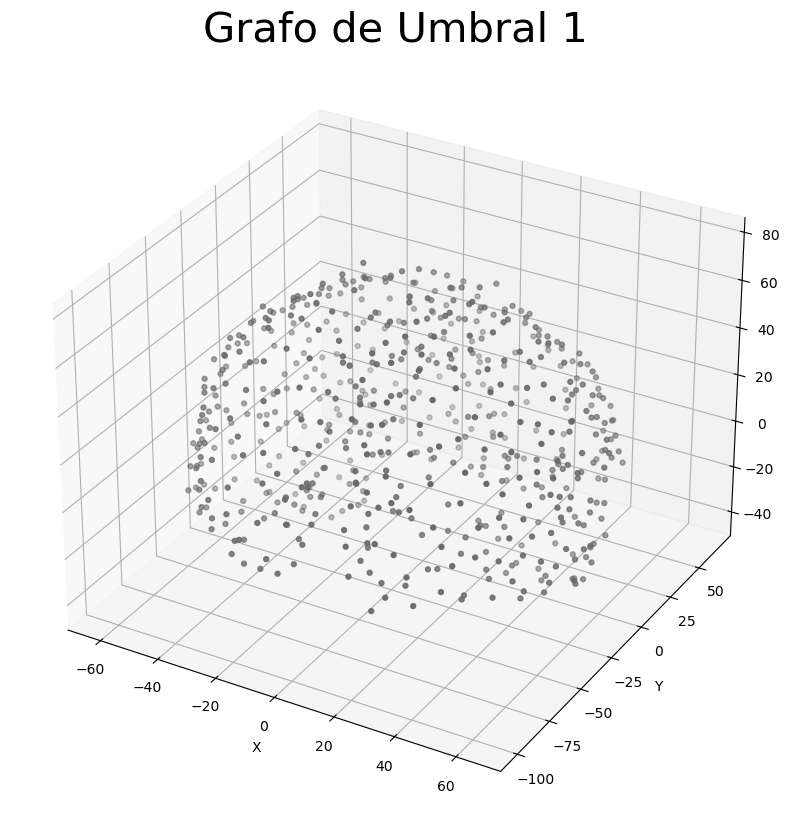

In [3]:
import scipy.io as sp
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

arch = sp.loadmat(r"C:\Users\vladi\OneDrive\Documentos\PYTHON\Coactivation_matrix.mat")
CM = arch['Coactivation_matrix']
coord = arch['Coord']
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]
m = 0

umbrales = [0.2, 0.8, 0.9, 1]

for u in umbrales:

    matriz_filtrada= np.where(CM >= u, 1, 0)
    G= nx.from_numpy_array(matriz_filtrada)
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(x, y, z, c='dimgray', s=50, marker='.')
    print(f'Para el grafo {u}, existen las siguientes coordenadas de Conexiones:\n')
    for edge in G.edges():
        node1, node2 = edge
        x_coords = [x[node1], x[node2]]
        y_coords = [y[node1], y[node2]]
        z_coords = [z[node1], z[node2]]
        ax.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
        m+= 1
        print('CONEXION: ','x: ', x_coords, 'y: ',y_coords, 'z',z_coords)
    
    ax.set_title(f'Grafo de Umbral {u}', fontsize= 30)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

plt.show()

# 2) Con uno de los grafos en el punto uno con umbral 0.9, generar una animacion donde se haga girar el grafo del cerebro para visualizar las conexiones establecidas.

### NOTA: decidí hacerlo de 0.2 porque el umbral de 0.9 no muestra conexiones. Dado este impedimento, no era posible conocer Hubs y por ende no se podia hacer el ejercicio 3, puesto que el las conexiones totales eran 0. 

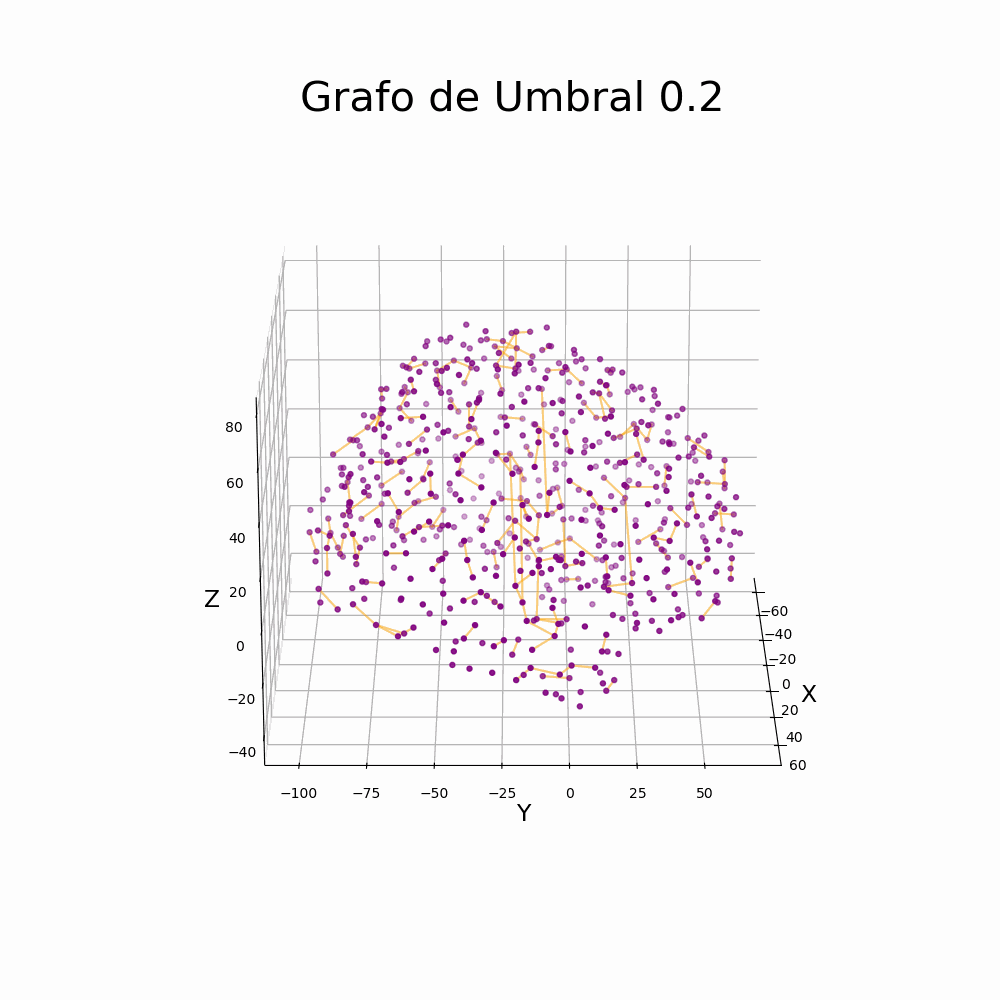

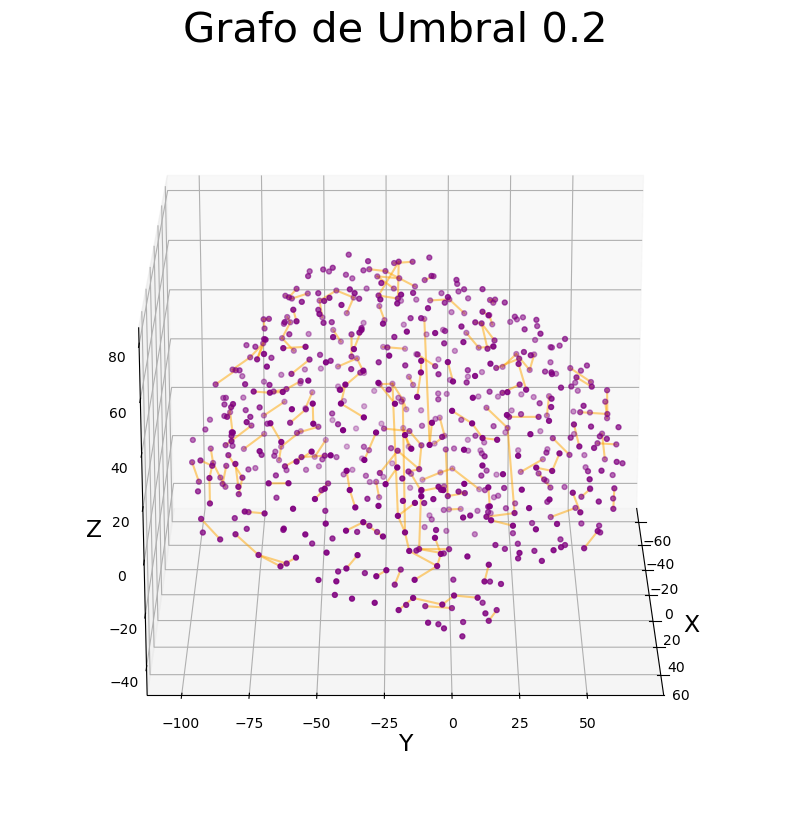

In [6]:
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image

arch = sp.loadmat(r"C:\Users\vladi\OneDrive\Documentos\PYTHON\Coactivation_matrix.mat")
CM = arch['Coactivation_matrix']
coord = arch['Coord']
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]
matriz_filtrada= np.where(CM >= 0.2, CM, 0)
G= nx.from_numpy_array(matriz_filtrada)
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection='3d')
ax.scatter(x, y, z, c='purple', s=50, marker='.')

for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)

ax.set_title(f'Grafo de Umbral 0.2', fontsize= 30)
ax.set_xlabel('X', fontsize= 17)
ax.set_ylabel('Y', fontsize= 17)
ax.set_zlabel('Z', fontsize= 17)


def init():
    ax.view_init(elev=20, azim=0)
    return fig,

def animate(frame):
    ax.view_init(elev=20, azim=frame)
    return fig,

animacion = FuncAnimation(fig, animate, init_func=init, frames=360, interval=50, blit=False)

### Para que podamos ver el giro en Jupyter tenemos que guardalo como gif y luego mostrarlo utilizando pillow 
karlenko = "grafo_animado.gif"
animacion.save(karlenko, writer=PillowWriter(fps=20))
Image(r"C:\Users\vladi\grafo_animado.gif")

# 3) Encontrar los hubs del grafo, y establecer el tamaño del nodo proporcional al valor del grado

### a) PRIMERO VOY A REALIZAR EL PLOT CAMBIANDO LOS TAMAÑOS SEGUN EL GRADO DEL NODO

Text(0.5, 0, 'Z')

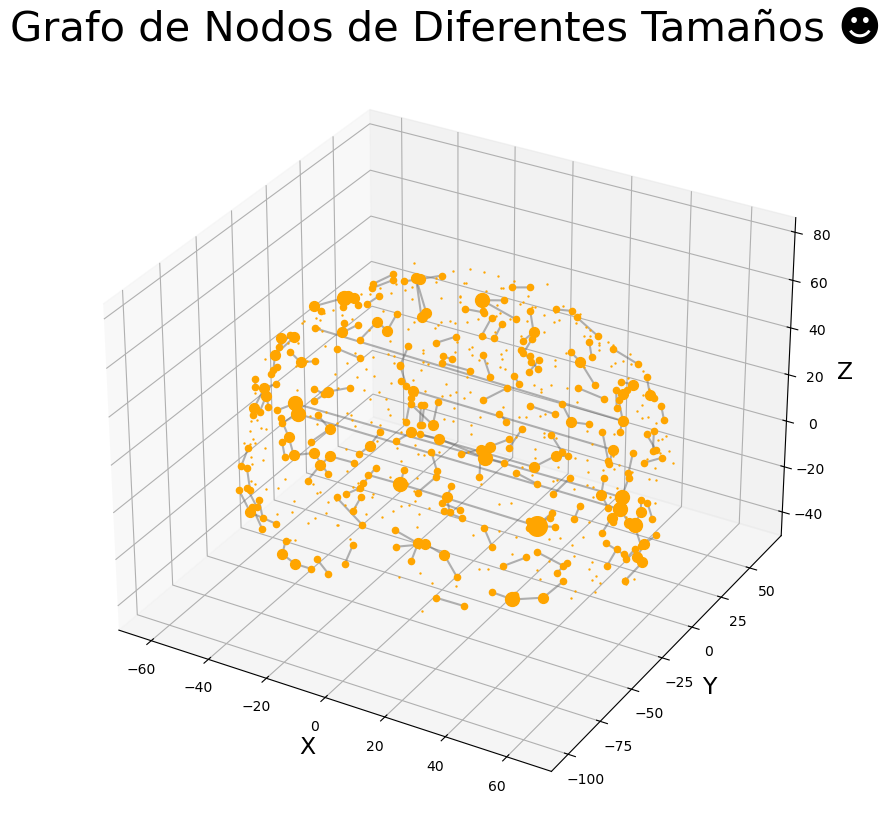

In [9]:
grados = dict(G.degree())
lista_grados = list(grados.values())
grado_maximo = max(lista_grados) #4
grado_minimo = min(lista_grados) #0

tam_max = 1
tam_min = 100

grado_tamaño = {0:0.50, 1:20, 2:50, 3:100, 4:200}

CM02 = arch['Coactivation_matrix']
matriz02_filtrada = np.where(CM02 >= 0.2, CM02, 0)
G02= nx.from_numpy_array(matriz_filtrada)
G01= nx.Graph()
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

figura = plt.figure(figsize= (10, 10))
Ax = figura.add_subplot(projection= '3d')

for nodo in grados.keys():
    valor= grados[nodo]
    tamaño= grado_tamaño[valor]
    Ax.scatter(x[nodo], y[nodo], z[nodo], color= 'orange', s= tamaño)

for edge in G02.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    Ax.plot(x_coords, y_coords, z_coords, c='dimgray', alpha=0.5)

Ax.set_title(f'Grafo de Nodos de Diferentes Tamaños ☻', fontsize= 30)
Ax.set_xlabel('X', fontsize= 17)
Ax.set_ylabel('Y', fontsize= 17)
Ax.set_zlabel('Z', fontsize= 17)

### b) AHORA VOY A ENCONTRAR LOS HUBS DEL GRAFO.....lo prometo >:v

In [11]:
Umbral = np.percentile(list(grados.values()), 99) ###ESCOGI UN PERCENTIL MUY ALTO PARA AUMENTAR MAS EL UMBRAL A 3
Hubs = [node for node, grado in grados.items() if grado >= Umbral]
print(f"Existen {len(Hubs)} Hubs que son los siguientes: {Hubs}", f'\nEn este caso, el umbral necesario para considerar un nodo como un Hub es {Umbral}')


Existen 11 Hubs que son los siguientes: [217, 226, 263, 404, 482, 599, 603, 615, 616, 618, 629] 
En este caso, el umbral necesario para considerar un nodo como un Hub es 3.0


# 4) En funcion de la matriz de emparejamiento(correlacion de la matriz de adyacencia), establecer una particion de los nodos en modulos. Escoger el numero de modulos que creas conveniente y justificar por que escogiste ese numero. 

C:\Users\vladi\anaconda3\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\vladi\anaconda3\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Text(0.5, 1.0, 'Matriz de Correlación Filtrada (0.2) CHIDA ☻')

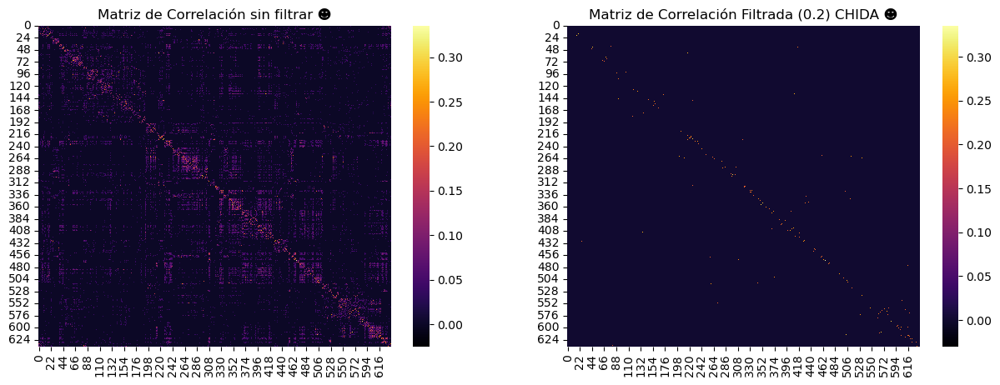

In [13]:
CM03 = arch['Coactivation_matrix']
coord = arch['Coord']
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

matriz_filtrada03 = np.where(CM03 >= 0.2, CM03, 0)
matriz_de_correlacion_sf= np.corrcoef(CM03)
matriz_de_correlacion = np.corrcoef(matriz_filtrada03)

plt.figure(figsize= (15, 5))

plt.subplot(1, 2, 1)
sns.heatmap(CM03, cmap='inferno', vmin= -0.025)
plt.title("Matriz de Correlación sin filtrar ☻")

plt.subplot(1, 2, 2)
sns.heatmap(matriz_filtrada03, cmap='inferno', vmin= -0.03)
plt.title("Matriz de Correlación Filtrada (0.2) CHIDA ☻")


### En este ejercicio utilice la funcion 'label_propagation_communities' el cual es una funcion que devuelve un conjunto de comunidades, donde cada comunidad es un conjunto de nodos que comparten la misma etiqueta. Sin embargo en la siguiente celda modifique el codigo de tal manera que sea posible introducir el numero de modulos que el usuario quiera. 

Comunidades encontradas: 462


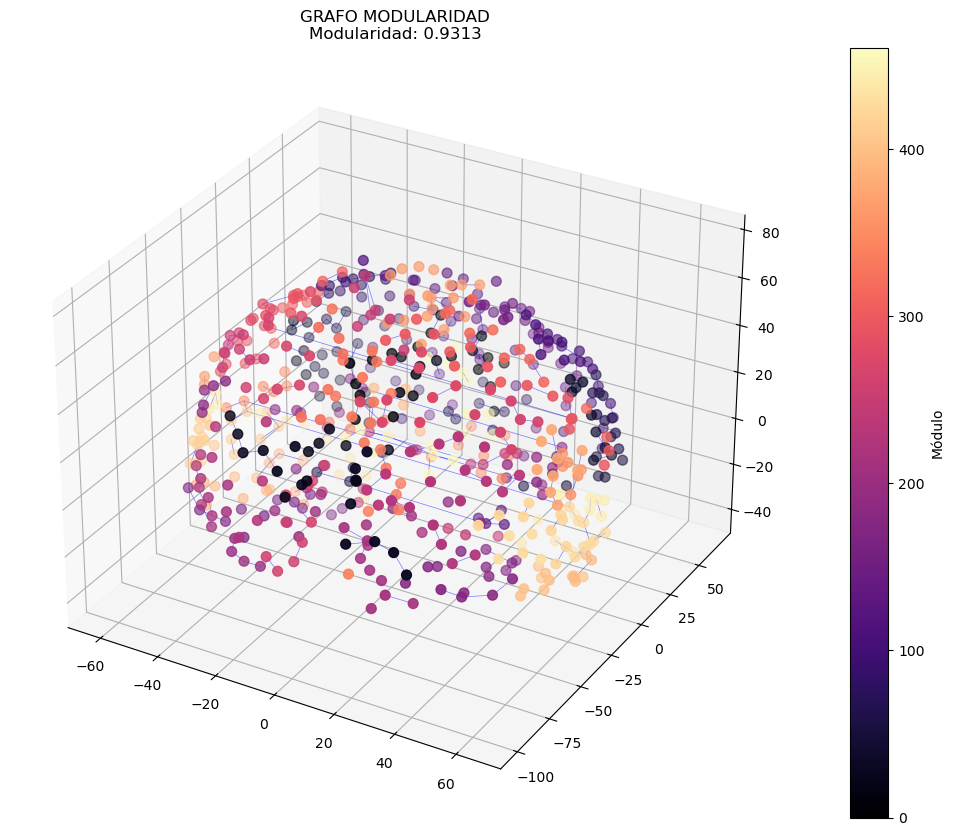

In [15]:
CM = arch['Coactivation_matrix']
matriz_filtrada = np.where(CM >= 0.2, CM, 0)
G = nx.from_numpy_array(matriz_filtrada)

def modulos_networkx(G, titulo):
    from networkx.algorithms.community import label_propagation_communities

    comunidades = list(label_propagation_communities(G))
    print(f"Comunidades encontradas: {len(comunidades)}")
    particion = {}
    
    for i, comunidad in enumerate(comunidades):
        for nodo in comunidad:
            particion[nodo] = i

    modularidad = nx.algorithms.community.quality.modularity(G, comunidades)
    nodcol = [particion[nodo] for nodo in G.nodes()]

    fig = plt.figure(figsize=(18, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    pos = {i: (x, y, z) for i, (x, y, z) in enumerate(arch['Coord'])}
    x, y, z = np.array(list(pos.values())).T
    scatter = ax.scatter(x, y, z, c=nodcol, cmap="magma", s=50, label='Nodos')
    
    for edge in G.edges():
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='b', alpha=0.5, linewidth=0.5)

    ax.set_title(f"{titulo}\nModularidad: {modularidad:.4f}")
    plt.colorbar(scatter, ax=ax, label="Módulo")
    plt.show()

modulos_networkx(G, "GRAFO MODULARIDAD")

INTRODUCE EL NUMERO DE MODULOS A UTILIZAR:  50


Modularidad calculada: 0.5017
Comunidades utilizadas: 50


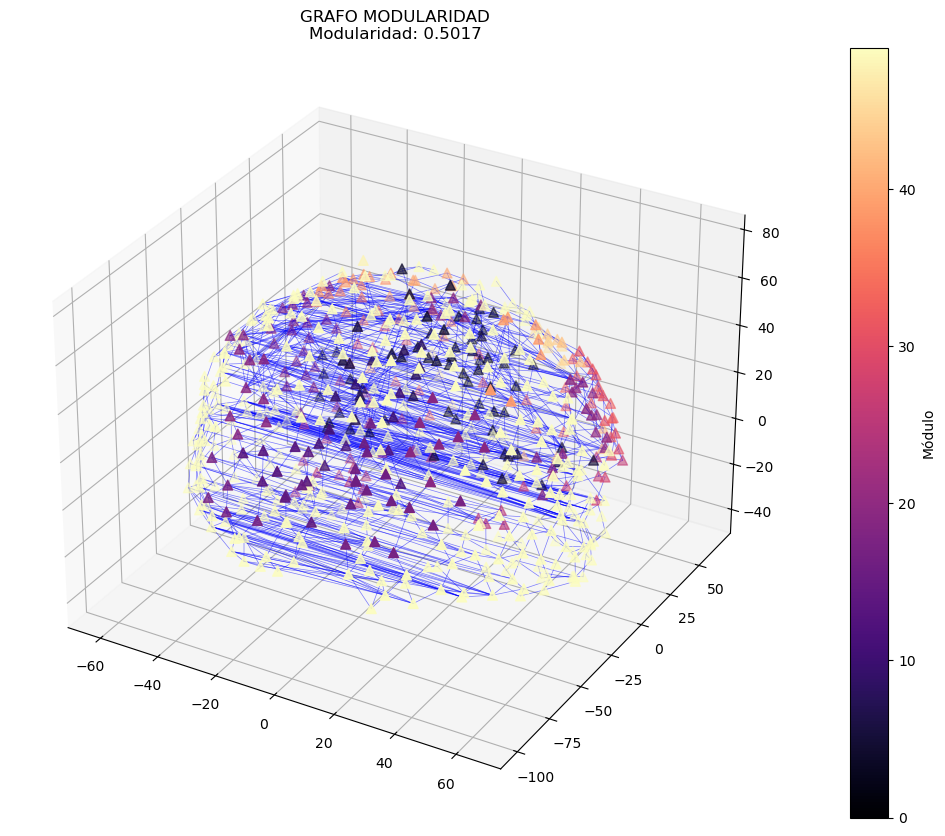

In [16]:
CM = arch['Coactivation_matrix']
matriz_filtrada = np.where(CM >= 0.1, CM, 0)
G = nx.from_numpy_array(matriz_filtrada)

def modulos_networkx(G, titulo, num_modulos=3):

    from networkx.algorithms.community import label_propagation_communities
    comunidades = list(label_propagation_communities(G))

    while len(comunidades) > num_modulos:
        comunidades[-2].update(comunidades[-1])
        comunidades = comunidades[:-1]  
        
    while len(comunidades) < num_modulos:
        comunidades[0].add(min(G.nodes()))  
        
    particion = {}
    for i, comunidad in enumerate(comunidades):
        for nodo in comunidad:
            particion[nodo] = i

    for nodo in G.nodes():
        if nodo not in particion:
            particion[nodo] = len(comunidades) - 1

    modularidad = nx.algorithms.community.quality.modularity(G, comunidades)
    print(f"Modularidad calculada: {modularidad:.4f}")
    print(f"Comunidades utilizadas: {len(comunidades)}")
    nodcol = [particion[nodo] for nodo in G.nodes()]

    fig = plt.figure(figsize=(18, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    pos = {i: (x, y, z) for i, (x, y, z) in enumerate(arch['Coord'])}
    x, y, z = np.array(list(pos.values())).T
    scatter = ax.scatter(x, y, z, c=nodcol, cmap="magma", s=50, label='Nodos', marker= '^')
    
    for edge in G.edges():
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='b', alpha=0.5, linewidth=0.5)

    
    ax.set_title(f"{titulo}\nModularidad: {modularidad:.4f}")
    plt.colorbar(scatter, ax=ax, label="Módulo")
    plt.show()

modulos_networkx(G, "GRAFO MODULARIDAD", num_modulos= 50)

### Dado que se trata de una red bastante compleja (638 nodos) yo prefiero utilizar la metodologia de las etiquetas de 'label_propagation_communities'. Sin embargo, si quisieramos definir de manera manual el numero de nodos, segun el estandar optimo de modularidad para redes biologicas esta en el rango de 0.3-0.7, para conseguir eso es necesario que los modulos se encuentren en el rango de 21-100 modulos (demasiados modulos, sin embargo pocos para los mostrados por Networkx).
### En el caso especifico de este ejercicio lo deje en 50 porque mostraba una modularidad optima....sin relentizar mi computadora jaja
### Tengo que mencionar que este ejercicio si me costo un poco jeje

# 5) Determinar el conjunto de Rich Club y discutir las implicaciones anatomicas y funcionales de este grupo de nodos (minimo 100 palabras) 

Rich Club (grado ≥ 2.0): [38, 42, 62, 69, 92, 124, 150, 217, 221, 223, 226, 230, 235, 245, 259, 260, 263, 275, 281, 290, 292, 296, 304, 309, 319, 320, 321, 327, 330, 331, 344, 352, 356, 358, 369, 393, 404, 407, 408, 416, 419, 428, 456, 460, 465, 482, 532, 547, 561, 565, 574, 579, 599, 603, 604, 605, 611, 613, 614, 615, 616, 617, 618, 622, 623, 628, 629]


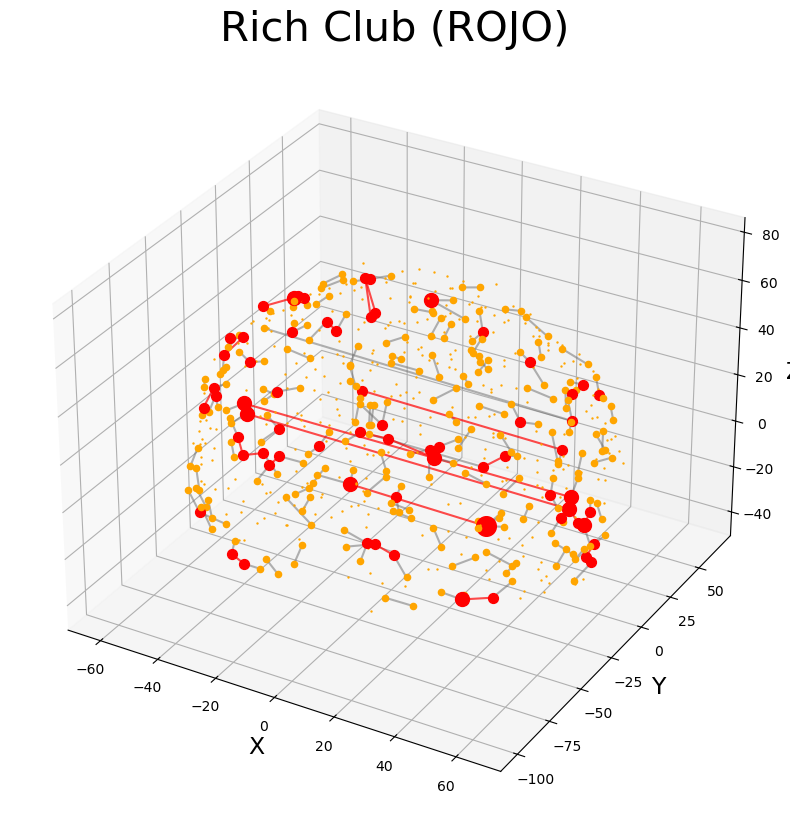

In [88]:
grados = dict(G02.degree())
grado_umbral = np.percentile(list(grados.values()), 90)
rich_club = [nodo for nodo, grado in grados.items() if grado >= grado_umbral]

print(f"Rich Club (grado ≥ {grado_umbral}): {rich_club}")

grado_tamaño = {0: 0.50, 1: 20, 2: 50, 3: 100, 4: 200}

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection='3d')

for nodo in grados.keys():
    valor = grados[nodo]
    tamaño = grado_tamaño.get(valor, 10)
    color = 'red' if nodo in rich_club else 'orange'
    Ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=tamaño)

for edge in G02.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    if node1 in rich_club and node2 in rich_club:
        Ax.plot(x_coords, y_coords, z_coords, c='red', alpha=0.7, linewidth=1.5)
    else: 
        Ax.plot(x_coords, y_coords, z_coords, c='dimgray', alpha=0.5)

Ax.set_title('Rich Club (ROJO)', fontsize=30)
Ax.set_xlabel('X', fontsize=17)
Ax.set_ylabel('Y', fontsize=17)
Ax.set_zlabel('Z', fontsize=17)
plt.show()


Analizando el plot generado, parece ser que las áreas más conectadas son las cortezas de asociación, esto tiene mucho sentido dado que se trata de regiones cerebrales encargadas de integrar la información de las distintas cortezas primarias (como cortezas visuales y auditivas). 
Además, algunas regiones que presentan esta conectividad son las áreas prefrontales. Esto también es lógico dada la importancia de estas áreas para la valoración de información y el control de otras áreas. 
Es decir, que todas las áreas que presentan esta conectividad son aquellas encargadas de la integración y análisis de información de distintas áreas primarias. Esto da como resultado un análisis de nivel superior de la información y una optimización de este proces.


# 6) no hay ejercicio 6 en el pdf jeje

# 7) Supongamos que eliminamos los nodos del Rich Club, describir como cambian las propiedades topologicas del grafo, hacer comparativas del grado, coeficiente de cluster, coeficiente de mundo pequeño y las medidas de centralidad (cercania, intermediacion)

### a) Primero obtenemos el plot del nuevo grafo y lo comparamos con el grafo sin modificar:

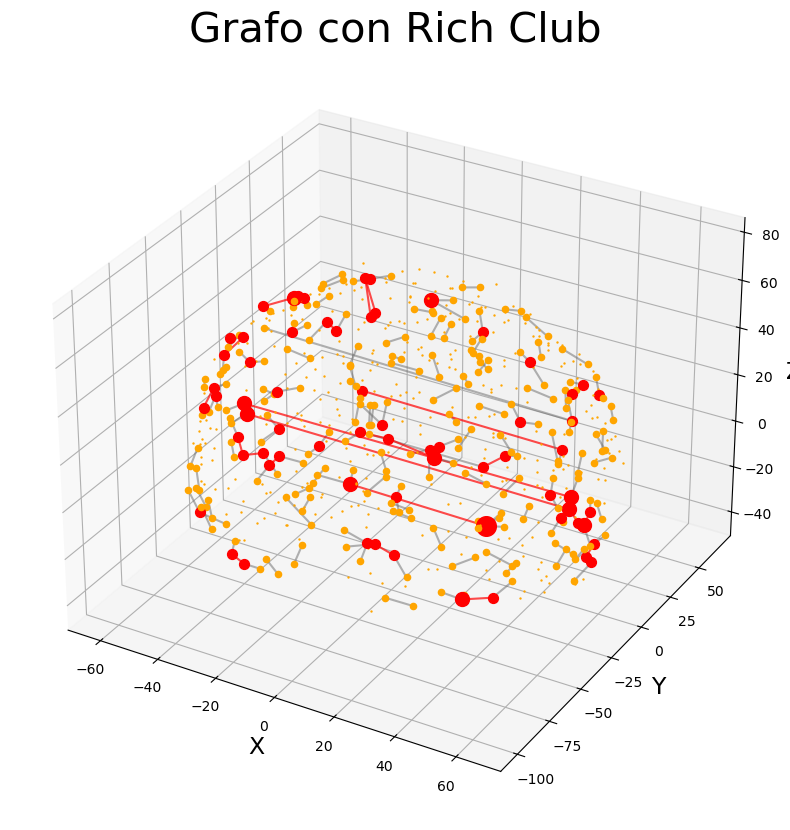

Rich Club (grado ≥ 2.0): [38, 42, 62, 69, 92, 124, 150, 217, 221, 223, 226, 230, 235, 245, 259, 260, 263, 275, 281, 290, 292, 296, 304, 309, 319, 320, 321, 327, 330, 331, 344, 352, 356, 358, 369, 393, 404, 407, 408, 416, 419, 428, 456, 460, 465, 482, 532, 547, 561, 565, 574, 579, 599, 603, 604, 605, 611, 613, 614, 615, 616, 617, 618, 622, 623, 628, 629]


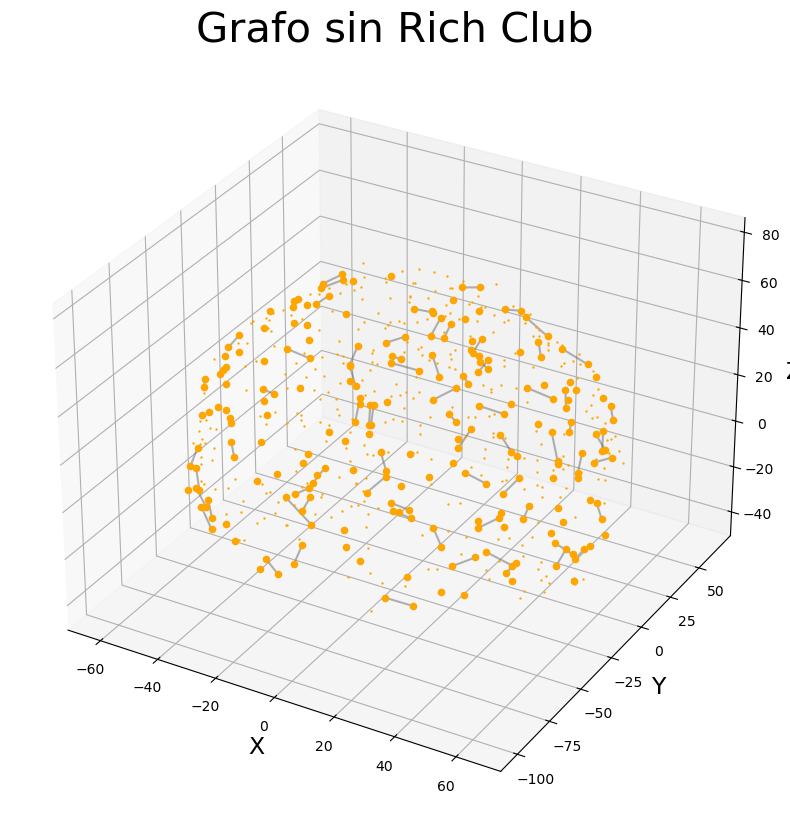

In [97]:
grados = dict(G02.degree())
grado_umbral = np.percentile(list(grados.values()), 90)
rich_club = [nodo for nodo, grado in grados.items() if grado >= grado_umbral]

grado_tamaño = {0: 0.50, 1: 20, 2: 50, 3: 100, 4: 200}

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection='3d')

for nodo in grados.keys():
    valor = grados[nodo]
    tamaño = grado_tamaño.get(valor, 10)
    color = 'red' if nodo in rich_club else 'orange'
    Ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=tamaño)

for edge in G02.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    if node1 in rich_club and node2 in rich_club:
        Ax.plot(x_coords, y_coords, z_coords, c='red', alpha=0.7, linewidth=1.5)
    else: 
        Ax.plot(x_coords, y_coords, z_coords, c='dimgray', alpha=0.5)

Ax.set_title('Grafo con Rich Club', fontsize=30)
Ax.set_xlabel('X', fontsize=17)
Ax.set_ylabel('Y', fontsize=17)
Ax.set_zlabel('Z', fontsize=17)
plt.show()



###### AHORA PLOTEAMOS EL GRAFO MODIFICADO

grados = dict(G02.degree())
grado_umbral = np.percentile(list(grados.values()), 90)
rich_club = [nodo for nodo, grado in grados.items() if grado >= grado_umbral]

print(f"Rich Club (grado ≥ {grado_umbral}): {rich_club}")

G_sin_rich_club = G02.copy()
G_sin_rich_club.remove_nodes_from(rich_club)

x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection='3d')

for nodo in G_sin_rich_club.nodes():
    valor = grados.get(nodo, 0)
    tamaño = grado_tamaño.get(valor, 10)
    Ax.scatter(x[nodo], y[nodo], z[nodo], color='orange', s=tamaño)

for edge in G_sin_rich_club.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    Ax.plot(x_coords, y_coords, z_coords, c='dimgray', alpha=0.5)

Ax.set_title('Grafo sin Rich Club', fontsize=30)
Ax.set_xlabel('X', fontsize=17)
Ax.set_ylabel('Y', fontsize=17)
Ax.set_zlabel('Z', fontsize=17)
plt.show()

### b) Ahora obtenemos los valores de las propiedades de cada uno de los grafos: 

In [80]:
grados = dict(G02.degree())
grado_umbral = np.percentile(list(grados.values()), 90)
rich_club = [nodo for nodo, grado in grados.items() if grado >= grado_umbral]

G_sin_rich_club = G02.copy()
G_sin_rich_club.remove_nodes_from(rich_club)

def calculo_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    propiedades["Grado promedio"] = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    
    propiedades["Centralidad de cercanía (promedio)"] = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades["Centralidad de intermediación (promedio)"] = np.mean(list(nx.betweenness_centrality(G).values()))
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    print()
    return propiedades

# Con Rich Club
propiedades_original = calculo_propiedades(G02, 'Original (sin modificar)')

# Sin Rich Club
propiedades_sin_rich_club = calculo_propiedades(G_sin_rich_club, 'Sin Rich Club (MODIFICADO)')


Propiedades del grafo Original (sin modificar):
  Número de nodos: 638
  Número de aristas: 188
  Grado promedio: 0.5893416927899686
  Coeficiente de clustering promedio: 0.004702194357366771
  Centralidad de cercanía (promedio): 0.0011233322643708667
  Centralidad de intermediación (promedio): 2.3135769952388597e-06

Propiedades del grafo Sin Rich Club (MODIFICADO):
  Número de nodos: 571
  Número de aristas: 73
  Grado promedio: 0.25569176882662
  Coeficiente de clustering promedio: 0.0
  Centralidad de cercanía (promedio): 0.0004485820505730175
  Centralidad de intermediación (promedio): 0.0



Lo que mas es notorio cuando retiramos los nodos del Rich Club es la ausencia de estructuras en el lobulo parietal y temporal. Lo que mas me sorprende es en el temporar dado que se pierde una buena parte del area de Wernike.
El cambio en este grafo pesa mas en el numero de conexiones, perdiendose mas de la mitad de las que tenia. Sin embargo, esto es logico dado que se han perdido los nodos del Rich Club y sus conexiones.

# 8) Quitar 10%-50% de los nodos con mayor medida de intermediacion y describir como cambian las propiedades topologicas del grafo, hacer comparativas del grado, coeficiente de cluster, coeficiente de mundo pequeño y medidas de centralidad (cercania, intermediacion)

### Para este ejercicio decidi utilizar una funcion, dado que se trataba de varios porcentajes y asi me era mas sencillo plotear cada uno de los nuevos grafos.

Propiedades del grafo original:
{'grado_medio': 0.25569176882662, 'coeficiente_de_agrupamiento': 0.0, 'centralidad_cercania': 0.0004485820505730175, 'centralidad_intermediacion': 0.0}

Propiedades tras eliminar 10% de nodos:
{'grado_medio': 0.2490272373540856, 'coeficiente_de_agrupamiento': 0.0, 'centralidad_cercania': 0.0004854332112165411, 'centralidad_intermediacion': 0.0}

Propiedades tras eliminar 20% de nodos:
{'grado_medio': 0.24945295404814005, 'coeficiente_de_agrupamiento': 0.0, 'centralidad_cercania': 0.0005470459518599562, 'centralidad_intermediacion': 0.0}

Propiedades tras eliminar 30% de nodos:
{'grado_medio': 0.24, 'coeficiente_de_agrupamiento': 0.0, 'centralidad_cercania': 0.0006015037593984962, 'centralidad_intermediacion': 0.0}

Propiedades tras eliminar 40% de nodos:
{'grado_medio': 0.26239067055393583, 'coeficiente_de_agrupamiento': 0.0, 'centralidad_cercania': 0.0007672241829062452, 'centralidad_intermediacion': 0.0}

Propiedades tras eliminar 50% de nodos:
{'grado

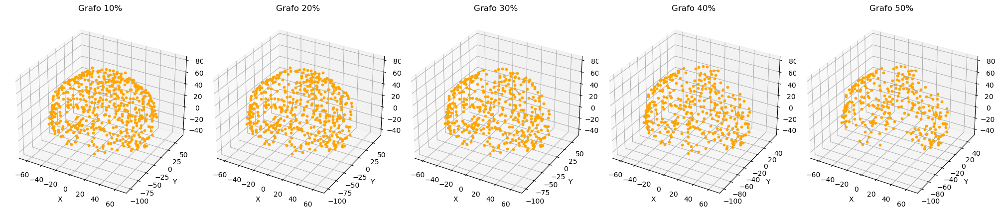

In [131]:
def propiedades_grafo(G):
    propiedades = {}

    # Grado medio
    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G)
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G)
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion
    return propiedades


def eliminacion_porcentaje(G, porcentaje):
    intermediacion = nx.betweenness_centrality(G)
    nodos_ordenados = sorted(intermediacion, key=intermediacion.get, reverse=True)
    num_nodos_eliminar = int(len(nodos_ordenados) * porcentaje / 100)
    nodos_a_eliminar = nodos_ordenados[:num_nodos_eliminar]

    G_modificado = G.copy()
    G_modificado.remove_nodes_from(nodos_a_eliminar)
    return G_modificado

def plot_grafo_3d_subplot(G, x, y, z, ax, titulo):
    for nodo in G.nodes():
        ax.scatter(x[nodo], y[nodo], z[nodo], color='orange', s=10)

    for edge in G.edges():
        node1, node2 = edge
        x_coords = [x[node1], x[node2]]
        y_coords = [y[node1], y[node2]]
        z_coords = [z[node1], z[node2]]
        ax.plot(x_coords, y_coords, z_coords, c='dimgray', alpha=0.5)

    ax.set_title(titulo, fontsize=12)
    ax.set_xlabel('X', fontsize=10)
    ax.set_ylabel('Y', fontsize=10)
    ax.set_zlabel('Z', fontsize=10)


grados = dict(G02.degree())
grado_umbral = np.percentile(list(grados.values()), 90)
rich_club = [nodo for nodo, grado in grados.items() if grado >= grado_umbral]
G_sin_rich_club = G02.copy()
G_sin_rich_club.remove_nodes_from(rich_club)

x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

print("Propiedades del grafo original:")
propiedades_originales = propiedades_grafo(G_sin_rich_club)
print(propiedades_originales)

porcentajes = [10, 20, 30, 40, 50]

fig, axs = plt.subplots(1, 5, figsize=(20, 6), subplot_kw={'projection': '3d'})

for i, porcentaje in enumerate(porcentajes):
    G_modificado = eliminacion_porcentaje(G_sin_rich_club, porcentaje)
    print(f"\nPropiedades tras eliminar {porcentaje}% de nodos:")
    propiedades_modificadas = propiedades_grafo(G_modificado)
    print(propiedades_modificadas)

    plot_grafo_3d_subplot(G_modificado, x, y, z, axs[i], f"Grafo {porcentaje}%")

plt.tight_layout()
plt.show()


# 9) Generar un modelo nulo aleatorio donde se tenga el mismo numero de nodos y el mismo numero total de conexiones, y comparar sus propiedades con el grado original del cerebro.


Propiedades del grafo original para el umbral 0.1:
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}

Propiedades del grafo nulo aleatorio para el umbral 0.1:
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.006833901034527994, 'centralidad_cercania': 0.22370560216510083, 'centralidad_intermediacion': 0.0053216294502659404}


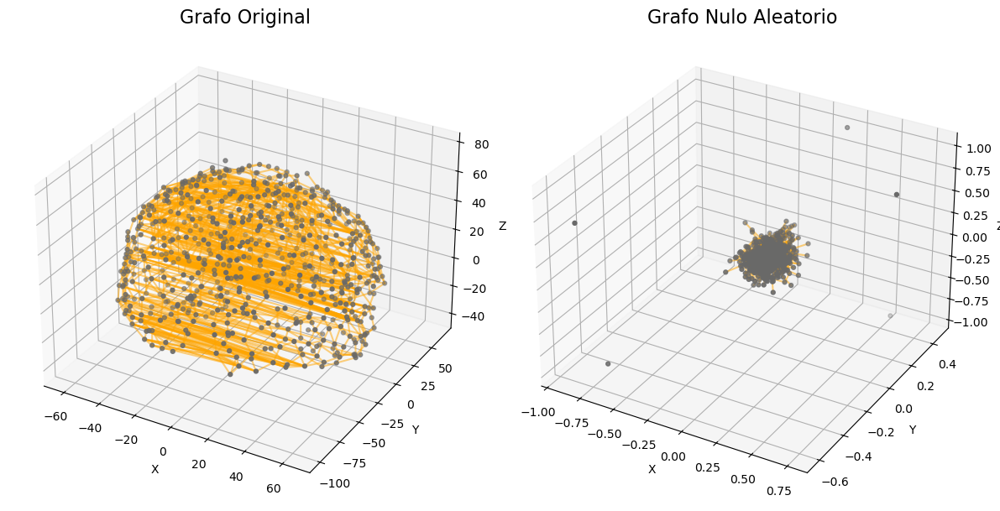

In [140]:
import scipy.io as sp
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

# Cargar datos
arch = sp.loadmat(r"C:\Users\vladi\OneDrive\Documentos\PYTHON\Coactivation_matrix.mat")
CM = arch['Coactivation_matrix']
coord = arch['Coord']
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

# Umbral específico
umbral = 0.1

# FUNCION 'VICENTE FERNANDEZ' PARA LAS PROPIEDADES
def propiedades_grafo(G):
    propiedades = {}
    
    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G)
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G)
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades

# FUNCION DE JOSE JOSE PARA LA GRAFICACION JAJAJAA
def grafo_nulo_aleatorio(num_nodos, num_aristas):

    G_random = nx.gnm_random_graph(num_nodos, num_aristas)
    return G_random


matriz_filtrada = np.where(CM >= umbral, CM, 0)
G = nx.from_numpy_array(matriz_filtrada)


num_nodos = G.number_of_nodes()
num_aristas = G.number_of_edges()


G_random = grafo_nulo_aleatorio(num_nodos, num_aristas)
    
print(f"\nPropiedades del grafo original para el umbral {umbral}:")
propiedades_original = propiedades_grafo(G)
print(propiedades_original)

print(f"\nPropiedades del grafo nulo aleatorio para el umbral {umbral}:")
propiedades_random = propiedades_grafo(G_random)
print(propiedades_random)


fig = plt.figure(figsize=(12, 6))

ax1 = fig.add_subplot(121, projection='3d')
ax1.scatter(x, y, z, c='dimgray', s=50, marker='.')
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax1.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
ax1.set_title(f'Grafo Original', fontsize=16)
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')

ax2 = fig.add_subplot(122, projection='3d')
pos_random = nx.spring_layout(G_random, dim=3)
x_r, y_r, z_r = np.array(list(pos_random.values())).T
ax2.scatter(x_r, y_r, z_r, c='dimgray', s=50, marker='.')
for edge in G_random.edges():
    node1, node2 = edge
    x_coords = [x_r[node1], x_r[node2]]
    y_coords = [y_r[node1], y_r[node2]]
    z_coords = [z_r[node1], z_r[node2]]
    ax2.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
ax2.set_title(f'Grafo Nulo Aleatorio', fontsize=16)
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')

plt.tight_layout()
plt.show()


# 10) Generar un modelo nulo aleatorio donde se conserve la distribucion de grado y comparar sus propiedades son el grafo original del cerebro.


Propiedades del grafo original para el umbral 0.1:
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}

Propiedades del grafo nulo aleatorio para el umbral 0.1:
{'grado_medio': 4.501567398119122, 'coeficiente_de_agrupamiento': 0.010436224346882654, 'centralidad_cercania': 0.22806002070754008, 'centralidad_intermediacion': 0.005174434884445108}


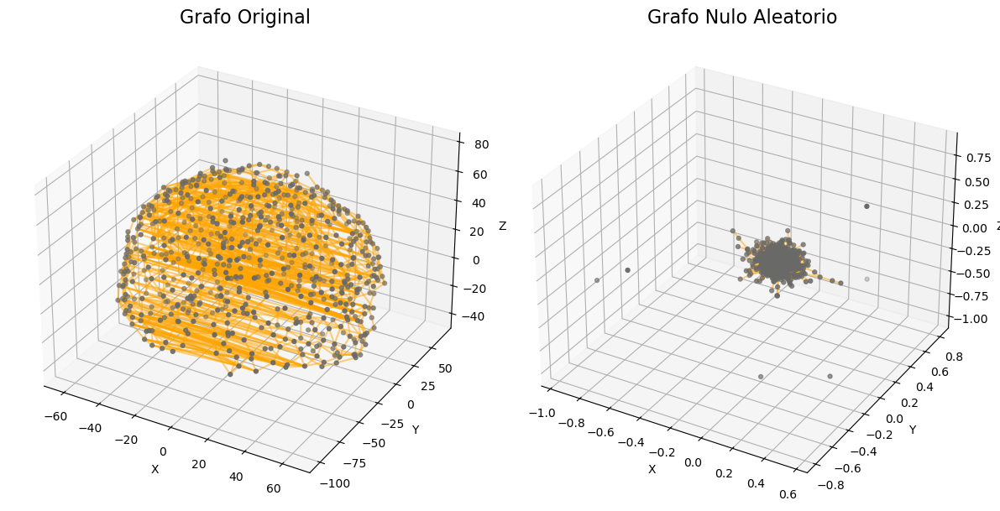

In [183]:
arch = sp.loadmat(r"C:\Users\vladi\OneDrive\Documentos\PYTHON\Coactivation_matrix.mat")
CM = arch['Coactivation_matrix']
coord = arch['Coord']
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

umbral = 0.1

def propiedades_grafo(G):
    propiedades = {}
    
    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G)
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G)
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades

def grafo_nulo_con_grados(G):
    G_random = nx.configuration_model([d for n, d in G.degree()])
    G_random = nx.Graph(G_random)
    
    G_random.remove_edges_from([(u, v) for u, v in G_random.edges() if u == v])

    return G_random

matriz_filtrada = np.where(CM >= umbral, CM, 0)
G = nx.from_numpy_array(matriz_filtrada)

num_nodos = G.number_of_nodes()
num_aristas = G.number_of_edges()

G_random = grafo_nulo_con_grados(G)
    
print(f"\nPropiedades del grafo original para el umbral {umbral}:")
propiedades_original = propiedades_grafo(G)
print(propiedades_original)

print(f"\nPropiedades del grafo nulo aleatorio para el umbral {umbral}:")
propiedades_random = propiedades_grafo(G_random)
print(propiedades_random)


fig = plt.figure(figsize=(12, 6))
ax1 = fig.add_subplot(121, projection='3d')
ax1.scatter(x, y, z, c='dimgray', s=50, marker='.')
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax1.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
ax1.set_title(f'Grafo Original', fontsize=16)
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')

ax2 = fig.add_subplot(122, projection='3d')
pos_random = nx.spring_layout(G_random, dim=3) 
x_r, y_r, z_r = np.array(list(pos_random.values())).T
ax2.scatter(x_r, y_r, z_r, c='dimgray', s=50, marker='.')
for edge in G_random.edges():
    node1, node2 = edge
    x_coords = [x_r[node1], x_r[node2]]
    y_coords = [y_r[node1], y_r[node2]]
    z_coords = [z_r[node1], z_r[node2]]
    ax2.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
ax2.set_title(f'Grafo Nulo Aleatorio', fontsize=16)
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')
plt.tight_layout()
plt.show()


### LA UNICA FORMA DE OBSERVAR QUE SE HAYA CONSERVADO LA DISTRIBUCION DE GRADOS ES MEDIANTE LOS RESPECTIVOS HISTOGRAMAS, ASI QUE LOS HICE...PUES YA QUE VERDAD JAJA:

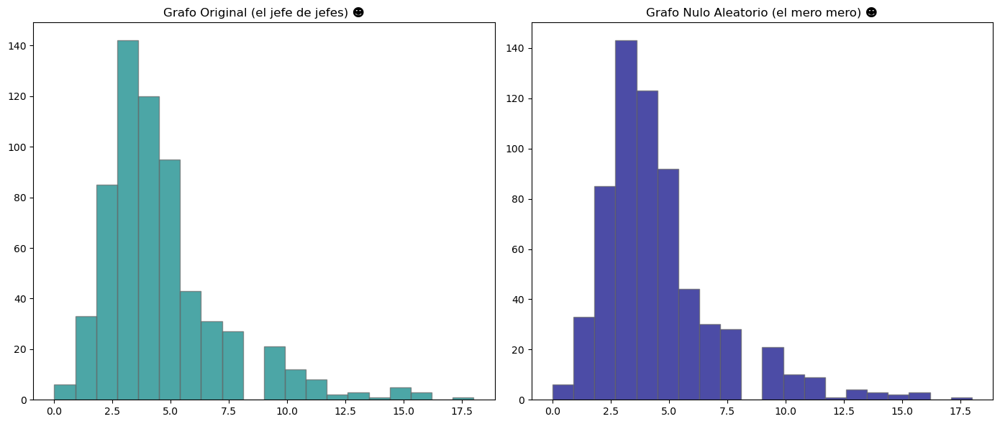

In [185]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Grafo original
ax1 = axes[0]
grados_original = [d for n, d in G.degree()]
ax1.hist(grados_original, bins=20, color='teal', edgecolor='dimgray', alpha=0.7)
ax1.set_title("Grafo Original (el jefe de jefes) ☻")

# Grafo nulo aleatorio
ax2 = axes[1]
grados_random = [d for n, d in G_random.degree()]
ax2.hist(grados_random, bins=20, color='navy', edgecolor='dimgray', alpha=0.7)
ax2.set_title("Grafo Nulo Aleatorio (el mero mero) ☻")

plt.tight_layout()
plt.show()

# 11 [el once jsjs]) Generar un modelo nulo utilizando una probabilidad de conexion en funcion de la distancia geometrica, con el mismo numero de nodos y conexiones y compara sus propiedades y discutir la importancia de las conexiones a la larga distancia en el cerebro.


Propiedades del grafo original
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}

Propiedades del grafo nulo aleatorio basado en distancia
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.006000669480293305, 'centralidad_cercania': 0.22308067683338478, 'centralidad_intermediacion': 0.005334505009195966}


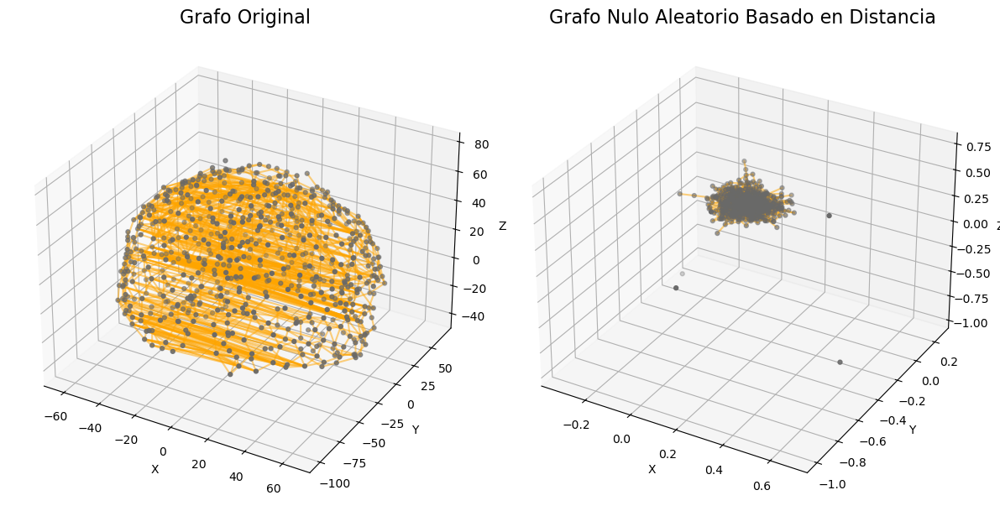

In [191]:
arch = sp.loadmat(r"C:\Users\vladi\OneDrive\Documentos\PYTHON\Coactivation_matrix.mat")
CM = arch['Coactivation_matrix']
coord = arch['Coord']
x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]

umbral = 0.1

def propiedades_grafo(G):
    propiedades = {}
    
    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G)
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G)
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades

def distancia_euclidiana(i, j, coord):
    return np.sqrt((coord[i, 0] - coord[j, 0]) ** 2 + (coord[i, 1] - coord[j, 1]) ** 2 + (coord[i, 2] - coord[j, 2]) ** 2)

def grafo_nulo_distancia(coord, num_nodos, num_aristas, alpha=0.1):
    G_random = nx.Graph()

    G_random.add_nodes_from(range(num_nodos))
    
    edges = []
    for i in range(num_nodos):
        for j in range(i + 1, num_nodos):
            dist = distancia_euclidiana(i, j, coord)
            p = 1 / (1 + alpha * dist) 
            if np.random.rand() < p:
                edges.append((i, j))
    
    while len(edges) > num_aristas:
        index = np.random.randint(0, len(edges))
        edges.pop(index)
    
    G_random.add_edges_from(edges)
    return G_random

matriz_filtrada = np.where(CM >= umbral, CM, 0)
G = nx.from_numpy_array(matriz_filtrada)

num_nodos = G.number_of_nodes()
num_aristas = G.number_of_edges()

G_random_dist = grafo_nulo_distancia(coord, num_nodos, num_aristas)

print(f"\nPropiedades del grafo original")
propiedades_original = propiedades_grafo(G)
print(propiedades_original)

print(f"\nPropiedades del grafo nulo aleatorio basado en distancia")
propiedades_random_dist = propiedades_grafo(G_random_dist)
print(propiedades_random_dist)

fig = plt.figure(figsize=(12, 6))

ax1 = fig.add_subplot(121, projection='3d')
ax1.scatter(x, y, z, c='dimgray', s=50, marker='.')
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax1.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
ax1.set_title(f'Grafo Original', fontsize=16)
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')

ax2 = fig.add_subplot(122, projection='3d')
pos_random = nx.spring_layout(G_random_dist, dim=3) 
x_r, y_r, z_r = np.array(list(pos_random.values())).T
ax2.scatter(x_r, y_r, z_r, c='dimgray', s=50, marker='.')
for edge in G_random_dist.edges():
    node1, node2 = edge
    x_coords = [x_r[node1], x_r[node2]]
    y_coords = [y_r[node1], y_r[node2]]
    z_coords = [z_r[node1], z_r[node2]]
    ax2.plot(x_coords, y_coords, z_coords, c='orange', alpha=0.5)
ax2.set_title(f'Grafo Nulo Aleatorio Basado en Distancia', fontsize=16)
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')

plt.tight_layout()
plt.show()


# 12) Escribir una reseña de lo aprendido en el curso, incluyendo la importancia de conocer herramientas de teoria de grafos para comprender la conectividad del cerebro (minimo 200 palabras)



# NOTAS:

Buen uso de funciones, aplicación de métodos de networkx (demuestra investigación)

Áreas de mejora: puedes reciclar funciones, la misma que hiciste para el ejercicio 3, usarla en el ejercicio 5 y así para simplificar código

- El cálculo de los hubs no fue correcto
- El cálculo de los conjuntos de Rich club
- Faltó tu reseña